# Imports

In [1]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import matplotlib

import fidimag
import sim_from_image as sfi
import os, re
import fidimag.common.constant as C
from fidimag.atomistic import UniformExchange, DMI, Anisotropy, DemagHexagonal
from fidimag.atomistic import Zeeman

import colorsys

import string

In [2]:
plt.style.use('lato_style.mplstyle')

# Functions

In [3]:
def convert_to_rgb(hls_color):
    return np.array(colorsys.hls_to_rgb(hls_color[0] / (2 * np.pi),
                                        hls_color[1],
                                        hls_color[2]
                                        ))

def generate_rgbs(field_data):
    """
    field_data      ::  (n, 3) array
    """
    hls = np.ones_like(field_data)
    hls[:, 0] = np.arctan2(field_data[:, 1],
                           field_data[:, 0]
                           )
    hls[:, 0][hls[:, 0] < 0] = hls[:, 0][hls[:, 0] < 0] + 2 * np.pi

    hls[:, 1] = 0.5 * (field_data[:, 2] + 1)
    # self.hls[:, 2] = 0.5 * (self.sim.spin.reshape(-1, 3)[:, 2] + 1)

    rgbs = np.apply_along_axis(convert_to_rgb, 1, hls)

    # Some RGB values can get very small magnitudes, like 1e-10:
    rgbs[rgbs < 0] += 2 * np.pi

    return rgbs

A function to extract the magnetic paramaters (magnetisation field, energy, topological charge, etc.) by loading relaxed states (saved in `npy` files) into a Fidimag simulation `sim`:. The data from this hystresis field process can be found in `../simulations/hysteresis/image_rotated_DT/`.

In [4]:
def load_magnetisation_hysteresis(sim, npys_folder, data_file, snaps_range, component='z',):
    """
    Assumes that sim has Zeeman interaction
    data_file  :: file in the dats folder with the hysteresis step and the
                  corresponding field magnitudes from the field sweep
                  
    Returns: m, Q, energy
    """

    cs = {'x': 0, 'y': 1, 'z': 2}
    m = []
    
    Q = []
    energy = []
    
    # NPY files from the hysteresis loop
    files_list = sorted(os.listdir(npys_folder), key=lambda f: int(re.search('\d+', f).group(0)))
    files_list = [files_list[i] for i in snaps_range]

    # data file wih the field magnitudes
    field_data = np.loadtxt(data_file)
    field_data = [field_data[i] for i in snaps_range]
    
    for i, npy_file in enumerate(files_list):
        sim.set_m(np.load(os.path.join(npys_folder, npy_file)))
        
        m_data = np.copy(sim.spin.reshape(-1, 3))
        if component == 'hsl':
            # print('m_data', m_data.shape)
            rgb_data = generate_rgbs(m_data)
            # print('rgb_data', rgb_data.shape)
            # rgb_data.shape = (m_data[:, 0].shape[0], m_data[:, 1].shape[0], 3)
            m.append(rgb_data)

        else:
            m.append(m_data[:, cs[component]])

        
        # Compute the total energy and store it in the energy list
        # We first need to update the field, which changes in every snapshot:
        # field data has: step Bx By Bz
        Bz = field_data[i][3]
        sim.get_interaction('Zeeman').update_field([0., 0., Bz])
        # print(sim.get_interaction('Zeeman').B0)
        sim.compute_effective_field(t=0)
        E = sim.compute_energy()
        energy.append(E)
    
        # Append topological number
        Q.append(sim.skyrmion_number(method='BergLuscher'))
    

    return m, Q, energy

# Load data

Make a simulation to load the magnetic configurations and extract the magnetisation field, Q number and the total energy:

In [5]:
mu_s = 'mu_s/Pd_Fe_Ir111_20160118_CrTip_015_B-4T_003_rotated_large_bw_mus3-muB.npy'
sim_from_image = sfi.sim_from_image(
    ('Romming_data/'
     'Pd_Fe_Ir111_20160118_CrTip_015_B-4T_003_rotated_large_bw/'
     'Pd_Fe_Ir111_20160118_CrTip_015_B-4T_003_rotated_large_bw.png'),
    image_range=[0, 21.03, 0, 17.79],
    sim_name="rotated_exp_hexagon"
    )
sim_from_image.generate_magnetic_moments(load_file=mu_s)
sim = sim_from_image.sim
mask = (sim.mu_s / C.mu_B) > 1e-5
exch = UniformExchange(5.881 * C.meV)
sim.add(exch)
dmi = DMI(D=1.557 * C.meV, dmi_type='interfacial')
sim.add(dmi)
sim.add(Zeeman([0., 0., 0.]))
sim.add(Anisotropy(0.406 * C.meV, axis=[0, 0, 1]))

# Base folder with the npys, dats data
base_folder = '../simulations/hysteresis/image_rotated_DT/'

npys_path = base_folder + 'npys/2Dhex_image-rotated_PdFe-Ir_B025e-1_seven-sks-down'
dat_path = base_folder + '/dats/2Dhex_image-rotated_PdFe-Ir_B025e-1_seven-sks-down_hyst_steps.dat'
m_7sks, Q_7sks, energy_7sks = load_magnetisation_hysteresis(sim, npys_path, dat_path, range(0, 51, 5), component='z')

npys_path = base_folder + '/npys/2Dhex_image-rotated_PdFe-Ir_B025e-1_six-sks-down'
dat_path = base_folder + '/dats/2Dhex_image-rotated_PdFe-Ir_B025e-1_six-sks-down_hyst_steps.dat'
m_6sks, Q_6sks, energy_6sks = load_magnetisation_hysteresis(sim, npys_path, dat_path, range(0, 51, 5), component='z')

npys_path = base_folder + '/npys/2Dhex_image-rotated_PdFe-Ir_B025e-1_five-sks-down/'
dat_path = base_folder + '/dats/2Dhex_image-rotated_PdFe-Ir_B025e-1_five-sks-down_hyst_steps.dat'
m_5sks, Q_5sks, energy_5sks = load_magnetisation_hysteresis(sim, npys_path, dat_path, range(0, 51, 5), component='z')

npys_path = base_folder + '/npys/2Dhex_image-rotated_PdFe-Ir_B025e-1_sk-down-helix/'
dat_path = base_folder + '/dats/2Dhex_image-rotated_PdFe-Ir_B025e-1_sk-down-helix_hyst_steps.dat'
m_helix_sk, Q_helix_sk, energy_helix_sk = load_magnetisation_hysteresis(sim, npys_path, dat_path, range(0, 51, 5), component='z')

npys_path = base_folder + '/npys/2Dhex_image-rotated_PdFe-Ir_B025e-1_fm-up/'
dat_path = base_folder + '/dats/2Dhex_image-rotated_PdFe-Ir_B025e-1_fm-up_hyst_steps.dat'
m_fm_up, Q_fm_up, energy_fm_up = load_magnetisation_hysteresis(sim, npys_path, dat_path, range(0, 51, 5), component='z')

Now we will compute the enrgy of the state where spins are completely aligned in the $+z$ direction, even at the boundaries. We will use the energy of this state as reference

In [6]:
sim.set_m((0, 0, 1))
Bzs = np.arange(2.5, -2.6, -0.5)
energy_down = []
for bz in Bzs:
    sim.get_interaction('Zeeman').update_field([0., 0., bz])
    sim.compute_effective_field(t=0)
    E = sim.compute_energy()
    energy_down.append(E)

# Field sweep plot

The field sweep process starting from 4 different initial configurations at 2.5 T and sweeping down to -2.5 T. We plot the snapshots using the magnetisation field data:

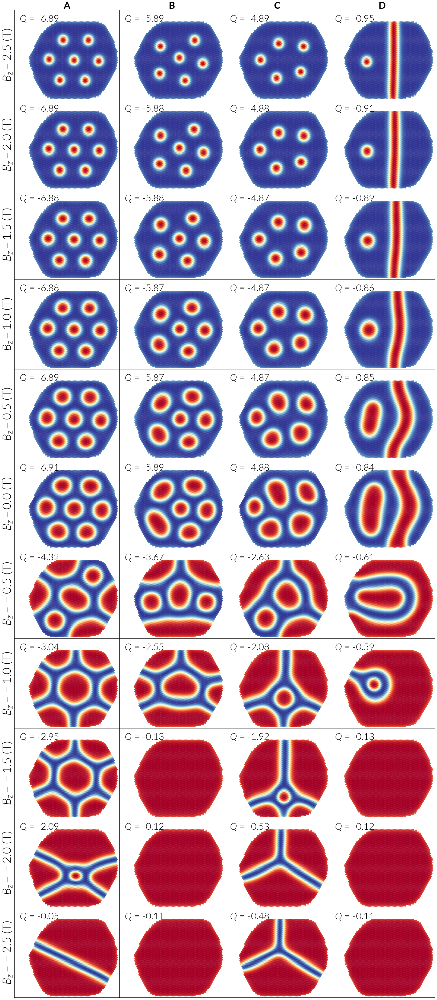

In [9]:
f, axs = plt.subplots(11, 4, sharex=True, sharey=True, figsize=(32, 77))

Q_states = [Q_7sks, Q_6sks, Q_5sks, Q_helix_sk]
for j, state in enumerate([m_7sks, m_6sks, m_5sks, m_helix_sk]):
    for i, m_field in enumerate(state):
        ax = axs.flatten()[j + 4 * i]
        ax.scatter(sim.mesh.coordinates[:, 0][mask], 
                   sim.mesh.coordinates[:, 1][mask],
                   c=m_field[mask], s=25, marker='h',
                   cmap='RdYlBu', vmin=-1, vmax=1
                   )
        ax.set_ylim([0, 20])
        ax.set_xlim([-3, 21])
        
        ax.text(0.05, 0.95, r'$Q$ = ' + '{:.2f}'.format(Q_states[j][i]),
                horizontalalignment='left',
                verticalalignment='top',
                transform=ax.transAxes, fontsize=40
                )
    
Bzs = np.arange(2.5, -2.6, -0.5)
for i, ax_index in enumerate(range(0, 41, 4)):
    ax = axs.flatten()[ax_index]
    ax.set_ylabel(r'$B_{z}=' + '{:.1f}'.format(Bzs[i]) + r'\,\,\mathrm{(T)}$', fontsize=50)
    ax.set_yticks([])

for ax_index in range(40, 44, 1):
    ax = axs.flatten()[ax_index]
    ax.set_xticks([])
    
titles = [r'A', r'B', r'C', r'D']
for i, ax_index in enumerate(range(0, 4, 1)):
    ax = axs.flatten()[ax_index]
    ax.set_title('{}'.format(titles[i]), weight='bold', fontsize=40)
    
f.subplots_adjust(hspace=0, wspace=0)

# plt.savefig('PdFeIr111_hysteresis_B_-2500mT_2500mT_step500mT_configurations.pdf', bbox_inches='tight')
# plt.savefig('PdFeIr111_hysteresis_B_-2500mT_2500mT_step500mT_configurations.jpg', dpi=150, bbox_inches='tight')

We can divide the plot in two parts:

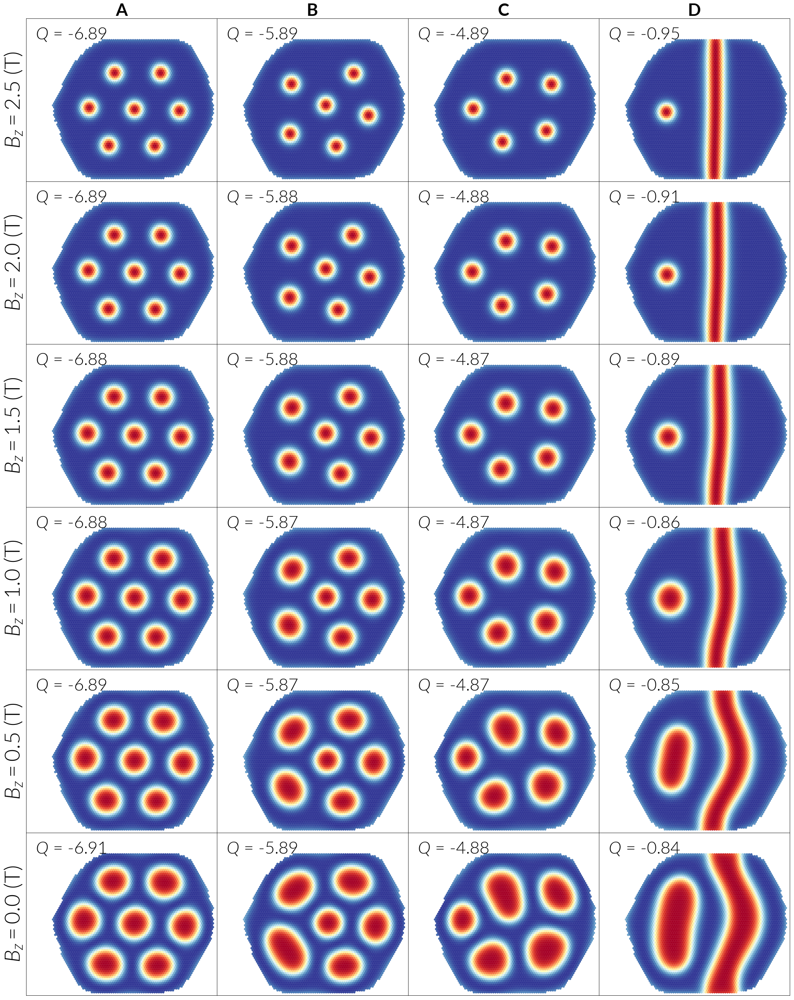

In [10]:
f, axs = plt.subplots(6, 4, sharex=True, sharey=True, figsize=(32, 42))

Q_states = [Q_7sks, Q_6sks, Q_5sks, Q_helix_sk]
for j, state in enumerate([m_7sks, m_6sks, m_5sks, m_helix_sk]):
    for i, m_field in enumerate(state[:6]):
        ax = axs.flatten()[j + 4 * i]
        ax.scatter(sim.mesh.coordinates[:, 0][mask], 
                   sim.mesh.coordinates[:, 1][mask],
                   c=m_field[mask], s=25, marker='h',
                   cmap='RdYlBu', vmin=-1, vmax=1
                   )
        ax.set_ylim([0, 20])
        ax.set_xlim([-3, 21])
        
        ax.text(0.05, 0.95, r'$Q$ = ' + '{:.2f}'.format(Q_states[j][i]),
                horizontalalignment='left',
                verticalalignment='top',
                transform=ax.transAxes, fontsize=40
                )
    
Bzs = np.arange(2.5, -2.6, -0.5)
for i, ax_index in enumerate(range(0, 24, 4)):
    ax = axs.flatten()[ax_index]
    ax.set_ylabel(r'$B_{z}=' + '{:.1f}'.format(Bzs[i]) + r'\,\,\mathrm{(T)}$', fontsize=50)
    ax.set_yticks([])

for ax_index in range(20, 24, 1):
    ax = axs.flatten()[ax_index]
    ax.set_xticks([])
        
titles = [r'A', r'B', r'C', r'D']
for i, ax_index in enumerate(range(0, 4, 1)):
    ax = axs.flatten()[ax_index]
    ax.set_title('{}'.format(titles[i]), weight='bold', fontsize=40)
    
f.subplots_adjust(hspace=0, wspace=0)
# plt.savefig('PdFeIr111_hysteresis_B_2500mT_-2500mT_step-500mT_configurations_I.pdf', bbox_inches='tight')
plt.savefig('PdFeIr111_hysteresis_B_2500mT_-2500mT_step-500mT_configurations_I.jpg', dpi=100, bbox_inches='tight')

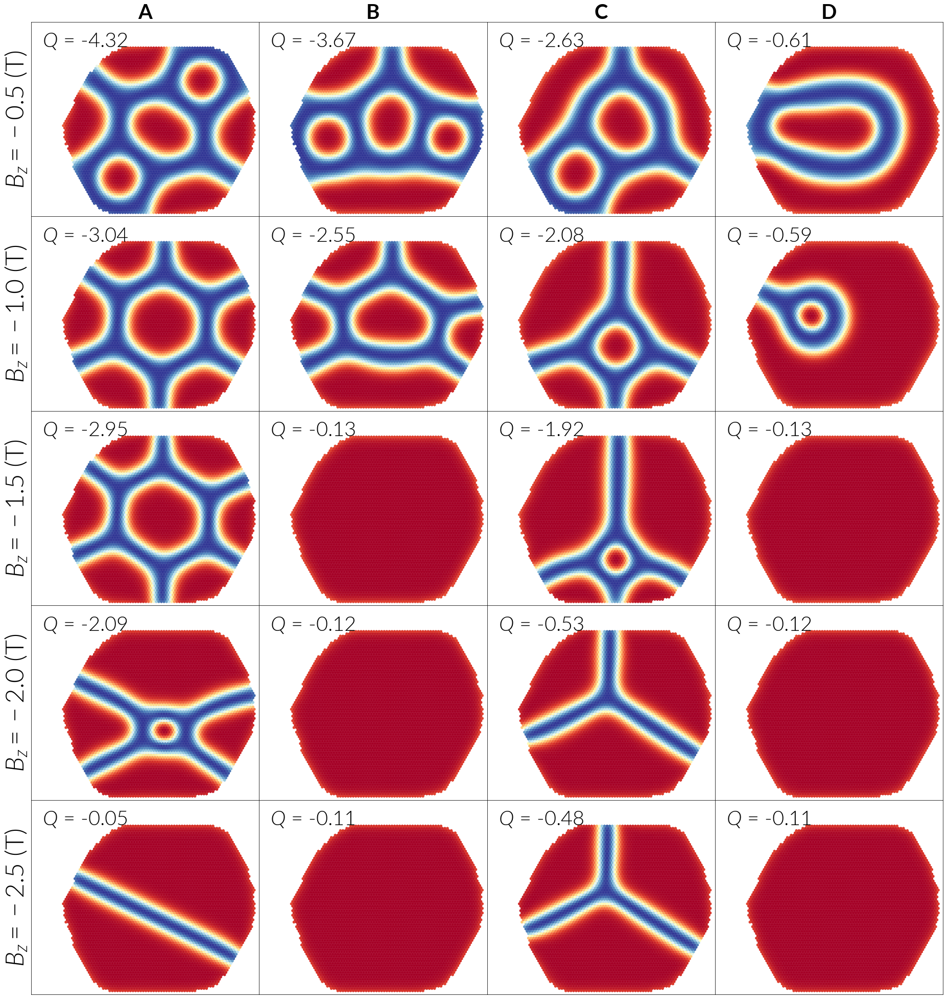

In [11]:
f, axs = plt.subplots(5, 4, sharex=True, sharey=True, figsize=(32, 35))

Q_states = [Q_7sks, Q_6sks, Q_5sks, Q_helix_sk]
for j, state in enumerate([m_7sks, m_6sks, m_5sks, m_helix_sk]):
    for i, m_field in enumerate(state[6:]):
        ax = axs.flatten()[j + 4 * i]
        ax.scatter(sim.mesh.coordinates[:, 0][mask], 
                   sim.mesh.coordinates[:, 1][mask],
                   c=m_field[mask], s=25, marker='h',
                   cmap='RdYlBu', vmin=-1, vmax=1
                   )
        ax.set_ylim([0, 20])
        ax.set_xlim([-3, 21])
        
        ax.text(0.05, 0.95, r'$Q$ = ' + '{:.2f}'.format(Q_states[j][6 + i]),
                horizontalalignment='left',
                verticalalignment='top',
                transform=ax.transAxes, fontsize=40
                )
    
Bzs = np.arange(2.5, -2.6, -0.5)
for i, ax_index in enumerate(range(0, 20, 4)):
    ax = axs.flatten()[ax_index]
    ax.set_ylabel(r'$B_{z}=' + '{:.1f}'.format(Bzs[6 + i]) + r'\,\,\mathrm{(T)}$', fontsize=50)
    ax.set_yticks([])

for ax_index in range(16, 20, 1):
    ax = axs.flatten()[ax_index]
    ax.set_xticks([])
    
titles = [r'A', r'B', r'C', r'D']
for i, ax_index in enumerate(range(0, 4, 1)):
    ax = axs.flatten()[ax_index]
    ax.set_title('{}'.format(titles[i]), weight='bold', fontsize=40)

f.subplots_adjust(hspace=0, wspace=0)
# plt.savefig('PdFeIr111_hysteresis_B_2500mT_-2500mT_step-500mT_configurations_II.pdf', bbox_inches='tight')
plt.savefig('PdFeIr111_hysteresis_B_2500mT_-2500mT_step-500mT_configurations_II.jpg', dpi=100, bbox_inches='tight')

# Energies

Here we compute the energy of every state in the field sweep process, for the 4 different processes with different initial states:

In [7]:
mu_s = 'mu_s/Pd_Fe_Ir111_20160118_CrTip_015_B-4T_003_rotated_large_bw_mus3-muB.npy'
sim_from_image = sfi.sim_from_image(
    ('Romming_data/'
     'Pd_Fe_Ir111_20160118_CrTip_015_B-4T_003_rotated_large_bw/'
     'Pd_Fe_Ir111_20160118_CrTip_015_B-4T_003_rotated_large_bw.png'),
    image_range=[0, 21.03, 0, 17.79],
    sim_name="rotated_exp_hexagon"
    )
sim_from_image.generate_magnetic_moments(load_file=mu_s)
sim = sim_from_image.sim
mask = (sim.mu_s / C.mu_B) > 1e-5
exch = UniformExchange(5.881 * C.meV)
sim.add(exch)
dmi = DMI(D=1.557 * C.meV, dmi_type='interfacial')
sim.add(dmi)
sim.add(Zeeman([0., 0., 0.]))
sim.add(Anisotropy(0.406 * C.meV, axis=[0, 0, 1]))

# Base folder with the npys, dats data
base_folder = '../simulations/hysteresis/image_rotated_DT/'

npys_path = base_folder + 'npys/2Dhex_image-rotated_PdFe-Ir_B025e-1_seven-sks-down'
dat_path = base_folder + '/dats/2Dhex_image-rotated_PdFe-Ir_B025e-1_seven-sks-down_hyst_steps.dat'
m_7sks, Q_7sks, energy_7sks = load_magnetisation_hysteresis(sim, npys_path, dat_path, range(0, 51, 1), component='z')

npys_path = base_folder + '/npys/2Dhex_image-rotated_PdFe-Ir_B025e-1_six-sks-down'
dat_path = base_folder + '/dats/2Dhex_image-rotated_PdFe-Ir_B025e-1_six-sks-down_hyst_steps.dat'
m_6sks, Q_6sks, energy_6sks = load_magnetisation_hysteresis(sim, npys_path, dat_path, range(0, 51, 1), component='z')

npys_path = base_folder + '/npys/2Dhex_image-rotated_PdFe-Ir_B025e-1_five-sks-down/'
dat_path = base_folder + '/dats/2Dhex_image-rotated_PdFe-Ir_B025e-1_five-sks-down_hyst_steps.dat'
m_5sks, Q_5sks, energy_5sks = load_magnetisation_hysteresis(sim, npys_path, dat_path, range(0, 51, 1), component='z')

npys_path = base_folder + '/npys/2Dhex_image-rotated_PdFe-Ir_B025e-1_sk-down-helix/'
dat_path = base_folder + '/dats/2Dhex_image-rotated_PdFe-Ir_B025e-1_sk-down-helix_hyst_steps.dat'
m_helix_sk, Q_helix_sk, energy_helix_sk = load_magnetisation_hysteresis(sim, npys_path, dat_path, range(0, 51, 1), component='z')

npys_path = base_folder + '/npys/2Dhex_image-rotated_PdFe-Ir_B025e-1_fm-up/'
dat_path = base_folder + '/dats/2Dhex_image-rotated_PdFe-Ir_B025e-1_fm-up_hyst_steps.dat'
m_fm_up, Q_fm_up, energy_fm_up = load_magnetisation_hysteresis(sim, npys_path, dat_path, range(0, 51, 1), component='z')

# Energy comparison

Energy of the fully uniform configurations (in the two opposite out of plane directions) for different fields:

In [8]:
sim.set_m((0, 0, 1))
Bzs = np.arange(2.5, -2.6, -0.1)
energy_up = []
for bz in Bzs:
    sim.get_interaction('Zeeman').update_field([0., 0., bz])
    sim.compute_effective_field(t=0)
    E = sim.compute_energy()
    energy_up.append(E)
    
sim.set_m((0, 0, -1))
Bzs = np.arange(2.5, -2.6, -0.1)
energy_down = []
for bz in Bzs:
    sim.get_interaction('Zeeman').update_field([0., 0., bz])
    sim.compute_effective_field(t=0)
    E = sim.compute_energy()
    energy_down.append(E)

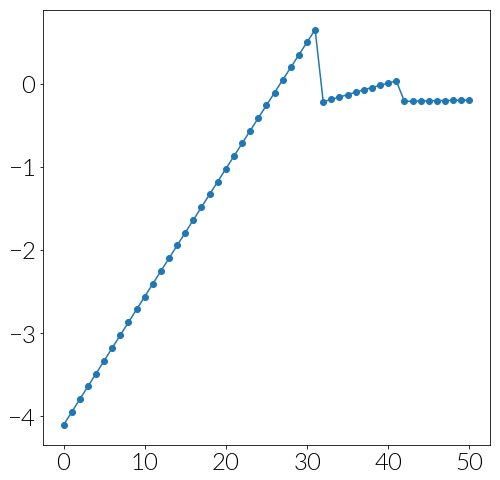

In [9]:
plt.plot((np.array(energy_fm_up) - np.array(energy_down))[:] / C.eV, 'o-')

Here we load the energies of the configurations found from experimental data. Number of the states are according to the snapshots in `../Romming_data/Pd_Fe_Ir111_configurations/`:

In [10]:
def sim_npy(i):
    fdir = ('../simulations/relaxation/image_rotated_relax-from-image/npys/'
            '2Dhex_image-rotated_PdFe-Ir_configuration-{:03d}_npys/'.format(i))
    return fdir + os.listdir(fdir)[-1]

# Fields in tesla for each configuration
fields = [0, 1, 1.25, 1.61, 2, 2.5, 2.5, 3, 4, 1.60, 1.60, -0.5, -0.5, -1.25, -1.60]

exp_data_up = []
exp_data_up_dict = {}

for j, i in enumerate(range(15)):
    sim.set_m(np.load(sim_npy(i)))
    sim.get_interaction('Zeeman').update_field([0., 0., fields[i]])
    sim.compute_effective_field(t=0)
    e = sim.compute_energy() / C.eV
    
    # Energy of the fully polarised state
    sim.set_m((0, 0, 1))
    sim.get_interaction('Zeeman').update_field([0., 0., fields[i]])
    sim.compute_effective_field(t=0)
    e_FP = sim.compute_energy() / C.eV
    
    # print('State {:03d} at a field of B={:>5.2f} T. E - E_FP = {:.5f} eV'.format(i, fields[i], e - e_FP))
    exp_data_up.append([i, fields[i], e - e_FP])
    exp_data_up_dict[i] = [fields[i], e - e_FP]
    
exp_data_up = np.array(exp_data_up)

# WITH RESPECT TO FM DOWN:

exp_data_down = []
exp_data_down_dict = {}

for j, i in enumerate(range(15)):
    sim.set_m(np.load(sim_npy(i)))
    sim.get_interaction('Zeeman').update_field([0., 0., fields[i]])
    sim.compute_effective_field(t=0)
    e = sim.compute_energy() / C.eV
    
    # Energy of the fully polarised state
    sim.set_m((0, 0, -1))
    sim.get_interaction('Zeeman').update_field([0., 0., fields[i]])
    sim.compute_effective_field(t=0)
    e_FP = sim.compute_energy() / C.eV
    
    # print('State {:03d} at a field of B={:>5.2f} T. E - E_FP = {:.5f} eV'.format(i, fields[i], e - e_FP))
    exp_data_down.append([i, fields[i], e - e_FP])
    exp_data_down_dict[i] = [fields[i], e - e_FP]
    
exp_data_down = np.array(exp_data_down)

Now we can plot the energies of the states from the field sweep simulations and the energies from the states obtained experimentally:

In [188]:
n_atoms = len(sim.mesh.coordinates[:, 0][sim.mu_s / C.mu_B > 1e-5])

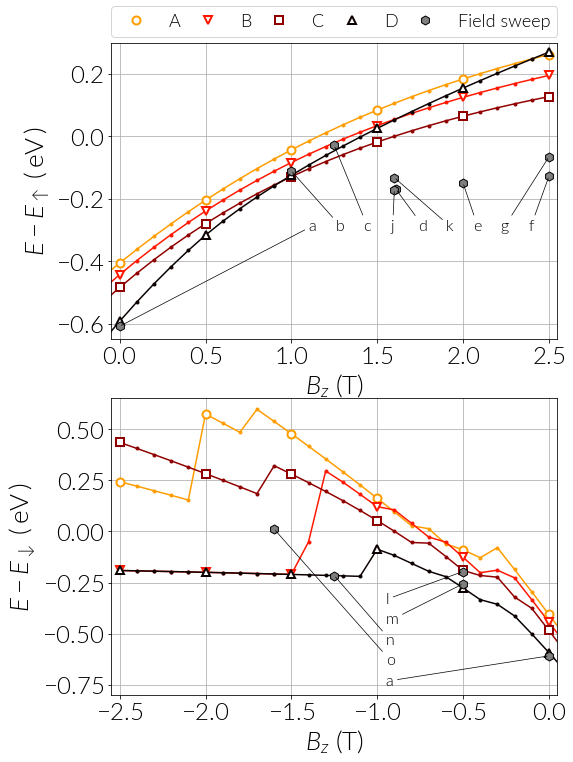

In [218]:
cm_subsection = np.linspace(0.4, 1, 4) 
cm_colors = [matplotlib.cm.hot_r(x) for x in cm_subsection]
markers = ['o', 'v', 's', '^', 'x']

# -----------------------------------------------------------------------------

f, axs = plt.subplots(ncols=1, nrows=2, figsize=(8, 12))
# ax = f.add_subplot(1, 1, 1)

Bzs = np.arange(2.5, -2.6, -0.1)
for k, ax in enumerate(axs):

    if k == 0:
        e_ref = np.array(energy_up) / C.eV
        e_data = exp_data_up
        e_data_dict = exp_data_up_dict
    else:
        e_ref = np.array(energy_down) / C.eV
        e_data = exp_data_down
        e_data_dict = exp_data_down_dict
    
    # ax = axs[0]
    ax.grid()

    labels = ['A', 'B', 'C', 'D']
    E_states = np.array([energy_7sks, energy_6sks, energy_5sks, energy_helix_sk]) / C.eV
    # energy_down_a = np.array(energy_down) / C.eV

    for i, energy in enumerate(E_states):
        ax.plot(Bzs[::], (energy - e_ref)[::], 'o-', color=cm_colors[i],
                # marker=markers[i],
                ms=3
                )

    for i, energy in enumerate(E_states):
        ax.plot(Bzs[::5], (energy - e_ref)[::5], 'o', color=cm_colors[i],
                marker=markers[i], label=labels[i],
                markerfacecolor='w', ms=8, mew=2
                )

    # Exp data:
    ftr = np.logical_and(e_data[:, 1] > -0.1, e_data[:, 1] < 2)
    ax.plot(e_data[:, 1], e_data[:, 2], 'h', color='C7', ms=9, label='Field sweep', mec='k')

    # ax.legend()

    ax.set_xticks([-2 + i * 1 for i in range(6)])

    if k == 0:
        e_data_list = [0, 1, 2, 9, 3, 10, 4, 6, 5]
    else:
        e_data_list = [11, 12, 13, 14, 0]

    # for j, i in enumerate(exp_data[:, 0].astype(np.int)):
    for j, i in enumerate(e_data_list):    
        xy = (e_data_dict[i][0], e_data_dict[i][1])

        if k == 0:
            xyt = (1.1 + 0.16 * j, -.3)
        else:
            xyt = (-0.95, -.35 - 0.1 * j)

        ax.annotate(string.ascii_lowercase[i],  # Instead of '{:02d}'.format(i), 
                    xy=xy, xytext=xyt,
                    arrowprops=dict(linewidth=0.7, facecolor='black', arrowstyle="-"),
                    fontsize=16, fontweight='light'
                    )
        
    if k == 0:
        ax.set_xlim(-0.05, 2.55)
        ax.set_ylim(-.65, 0.3)
        ax.set_ylabel(r'$E - E_{\uparrow}\,\,(\,\mathrm{eV}\,)$')
        ax.legend(ncol=5, loc='lower left',
                  bbox_to_anchor=(0, 1.02, 1.0, 1),
                  mode='expand', borderaxespad=0.,
                  fontsize=18)
        ax.set_xticks([2.5 - 0.5 * f for f in range(6)])
    else:
        ax.set_xlim(-2.55, 0.05)
        ax.set_ylim(-.8, 0.65)
        ax.set_ylabel(r'$E - E_{\downarrow}\,\,(\,\mathrm{eV}\,)$')
        ax.set_xticks([-2.5 + 0.5 * f for f in range(6)])
        
        
    ax.set_xlabel(r'$B_{z}\,\,(\mathrm{T})$')
# plt.subplots_adjust(hspace=0)
        
plt.savefig('PdFeIr111_hysteresis_B_2500mT_-2500mT_step-500mT_energies.pdf', bbox_inches='tight')

## Horizontal axis

The same plot but lied horizontally:

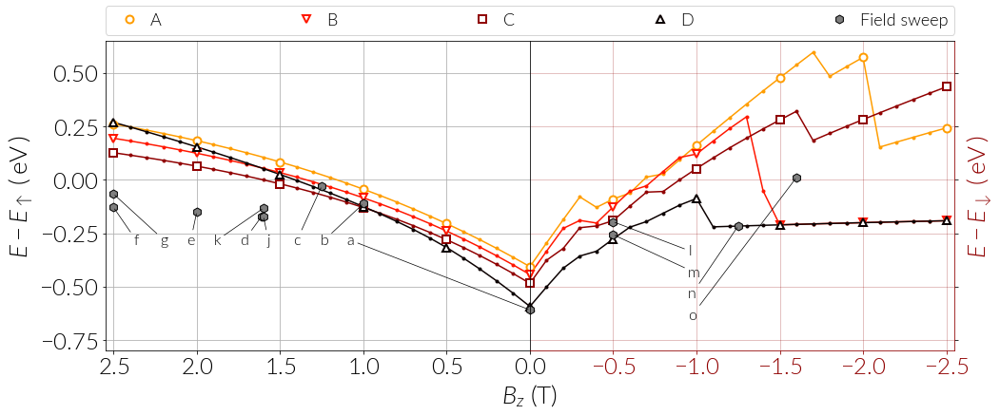

In [52]:
cm_subsection = np.linspace(0.4, 1, 4) 
cm_colors = [matplotlib.cm.hot_r(x) for x in cm_subsection]
markers = ['o', 'v', 's', '^', 'x']

# -----------------------------------------------------------------------------

f, axs = plt.subplots(ncols=2, nrows=1, figsize=(16, 6))
# ax = f.add_subplot(1, 1, 1)

Bzs = np.arange(2.5, -2.6, -0.1)
for k, ax in enumerate(axs):

    if k == 0:
        e_ref = np.array(energy_up) / C.eV
        e_data = exp_data_up
        e_data_dict = exp_data_up_dict
    else:
        e_ref = np.array(energy_down) / C.eV
        e_data = exp_data_down
        e_data_dict = exp_data_down_dict
    
    # ax = axs[0]

    labels = ['A', 'B', 'C', 'D']
    E_states = np.array([energy_7sks, energy_6sks, energy_5sks, energy_helix_sk]) / C.eV
    # energy_down_a = np.array(energy_down) / C.eV

    for i, energy in enumerate(E_states):
        ax.plot(Bzs[::], (energy - e_ref)[::], 'o-', color=cm_colors[i],
                # marker=markers[i],
                ms=3
                )

    for i, energy in enumerate(E_states):
        ax.plot(Bzs[::5], (energy - e_ref)[::5], 'o', color=cm_colors[i],
                marker=markers[i], label=labels[i],
                markerfacecolor='w', ms=8, mew=2
                )

    # Exp data:
    ftr = np.logical_and(e_data[:, 1] > -0.1, e_data[:, 1] < 2)
    ax.plot(e_data[:, 1], e_data[:, 2], 'h', color='C7', ms=9, label='Field sweep', mec='k')

    # ax.legend()
    
    if k == 0:
        e_data_list = [0, 1, 2, 9, 3, 10, 4, 6, 5]
    else:
        e_data_list = [11, 12, 13, 14]

    # for j, i in enumerate(exp_data[:, 0].astype(np.int)):
    for j, i in enumerate(e_data_list):    
        xy = (e_data_dict[i][0], e_data_dict[i][1])

        if k == 0:
            xyt = (1.1 + 0.16 * j, -.3)
        else:
            xyt = (-0.95, -.35 - 0.1 * j)

        ax.annotate(string.ascii_lowercase[i],  # Instead of '{:02d}'.format(i), 
                    xy=xy, xytext=xyt,
                    arrowprops=dict(linewidth=0.7, facecolor='black', arrowstyle="-"),
                    fontsize=16, fontweight='light'
                    )
        
    if k == 0:
        ax.set_xlim(2.55, 0)
        # ax.set_ylim(-.65, 0.3)
        ax.set_ylabel(r'$E - E_{\uparrow}\,\,(\,\mathrm{eV}\,)$')
        ax.legend(ncol=5, loc='lower left',
                  bbox_to_anchor=(0, 1.02, 2.0, 1),
                  mode='expand', borderaxespad=0.,
                  fontsize=18,
                  handletextpad=0.2
                  )
        ax.set_xticks([2.5 - 0.5 * f for f in range(6)])
        
        ax.spines['right'].set_visible(False)
        ax.grid()
        
    else:
        ax.yaxis.tick_right()
        ax.yaxis.set_label_position("right")
        ax.set_yticklabels([])
        
        ax.set_xlim(0.0, -2.55)
        # ax.set_ylim(-.8, 0.65)
        ax.set_ylabel(r'$E - E_{\downarrow}\,\,(\,\mathrm{eV}\,)$', color=cm_colors[2])
        ax.set_xticks([-2.5 + 0.5 * f for f in range(5)])
        
        # ax.spines['left'].set_visible(False)
        
        ax.set_xlabel(r'$B_{z}\,\,(\mathrm{T})$')
        ax.xaxis.set_label_coords(0, -0.1)
        ax.tick_params(axis='x', colors=cm_colors[2])
        ax.spines['bottom'].set_color(cm_colors[2])
        ax.spines['right'].set_color(cm_colors[2])
        
        ax.grid(color=cm_colors[2], alpha=0.3)
        
                
    ax.set_ylim(-.8, 0.65)
    
plt.subplots_adjust(wspace=0)
        
plt.savefig('PdFeIr111_hysteresis_B_2500mT_-2500mT_step-500mT_energies.pdf', bbox_inches='tight')

## HSV

Field sweep with a HSV colormap

In [25]:
mu_s = 'mu_s/Pd_Fe_Ir111_20160118_CrTip_015_B-4T_003_rotated_large_bw_mus3-muB.npy'
sim_from_image = sfi.sim_from_image(
    ('Romming_data/'
     'Pd_Fe_Ir111_20160118_CrTip_015_B-4T_003_rotated_large_bw/'
     'Pd_Fe_Ir111_20160118_CrTip_015_B-4T_003_rotated_large_bw.png'),
    image_range=[0, 21.03, 0, 17.79],
    sim_name="rotated_exp_hexagon"
    )
sim_from_image.generate_magnetic_moments(load_file=mu_s)
sim = sim_from_image.sim
mask = (sim.mu_s / C.mu_B) > 1e-5
exch = UniformExchange(5.881 * C.meV)
sim.add(exch)
dmi = DMI(D=1.557 * C.meV, dmi_type='interfacial')
sim.add(dmi)
sim.add(Zeeman([0., 0., 0.]))
sim.add(Anisotropy(0.406 * C.meV, axis=[0, 0, 1]))


# Base folder with the npys, dats data
base_folder = '../simulations/hysteresis/image_rotated_DT/'

npys_path = base_folder + 'npys/2Dhex_image-rotated_PdFe-Ir_B025e-1_seven-sks-down'
dat_path = base_folder + '/dats/2Dhex_image-rotated_PdFe-Ir_B025e-1_seven-sks-down_hyst_steps.dat'
m_7sks, Q_7sks, energy_7sks = load_magnetisation_hysteresis(sim, npys_path, dat_path, range(0, 51, 5), component='hsl')

npys_path = base_folder + '/npys/2Dhex_image-rotated_PdFe-Ir_B025e-1_six-sks-down'
dat_path = base_folder + '/dats/2Dhex_image-rotated_PdFe-Ir_B025e-1_six-sks-down_hyst_steps.dat'
m_6sks, Q_6sks, energy_6sks = load_magnetisation_hysteresis(sim, npys_path, dat_path, range(0, 51, 5), component='hsl')

npys_path = base_folder + '/npys/2Dhex_image-rotated_PdFe-Ir_B025e-1_five-sks-down/'
dat_path = base_folder + '/dats/2Dhex_image-rotated_PdFe-Ir_B025e-1_five-sks-down_hyst_steps.dat'
m_5sks, Q_5sks, energy_5sks = load_magnetisation_hysteresis(sim, npys_path, dat_path, range(0, 51, 5), component='hsl')

npys_path = base_folder + '/npys/2Dhex_image-rotated_PdFe-Ir_B025e-1_sk-down-helix/'
dat_path = base_folder + '/dats/2Dhex_image-rotated_PdFe-Ir_B025e-1_sk-down-helix_hyst_steps.dat'
m_helix_sk, Q_helix_sk, energy_helix_sk = load_magnetisation_hysteresis(sim, npys_path, dat_path, range(0, 51, 5), component='hsl')

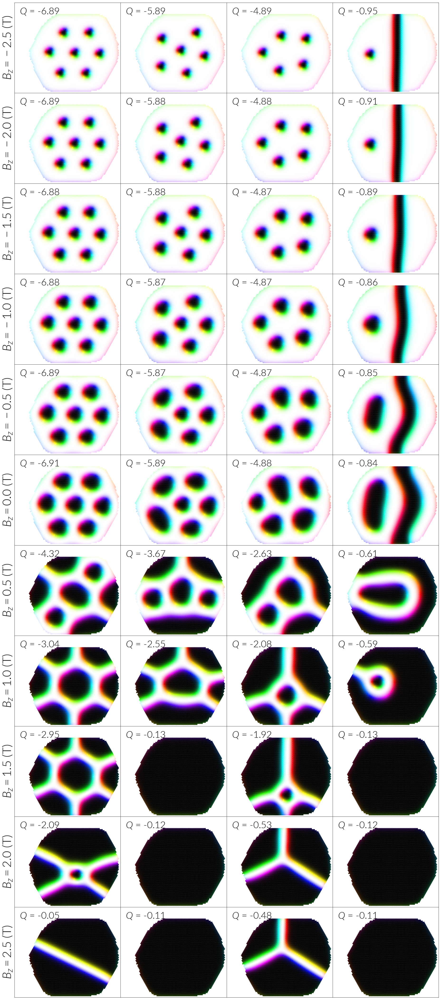

In [26]:
f, axs = plt.subplots(11, 4, sharex=True, sharey=True, figsize=(32, 77))

Q_states = [Q_7sks, Q_6sks, Q_5sks, Q_helix_sk]
for j, state in enumerate([m_7sks, m_6sks, m_5sks, m_helix_sk]):
    for i, m_field in enumerate(state):
        ax = axs.flatten()[j + 4 * i]
        ax.scatter(sim.mesh.coordinates[:, 0][mask], 
                   sim.mesh.coordinates[:, 1][mask],
                   color=m_field[mask], 
                   s=25, marker='h',
                   # cmap='RdYlBu', vmin=-1, vmax=1
                   )
        ax.set_ylim([0, 20])
        ax.set_xlim([-3, 21])
        
        ax.text(0.05, 0.95, r'$Q$ = ' + '{:.2f}'.format(Q_states[j][i]),
                horizontalalignment='left',
                verticalalignment='top',
                transform=ax.transAxes, fontsize=40
                )
    
Bzs = np.arange(-2.5, 2.6, 0.5)
for i, ax_index in enumerate(range(0, 41, 4)):
    ax = axs.flatten()[ax_index]
    ax.set_ylabel(r'$B_{z}=' + '{:.1f}'.format(Bzs[i]) + r'\,\,\mathrm{(T)}$', fontsize=50)
    ax.set_yticks([])

for ax_index in range(40, 44, 1):
    ax = axs.flatten()[ax_index]
    ax.set_xticks([])
    
f.subplots_adjust(hspace=0, wspace=0)

# plt.savefig('PdFeIr111_hysteresis_B_-2500mT_2500mT_step500mT_configurations_HSL.pdf', bbox_inches='tight')
plt.savefig('PdFeIr111_hysteresis_B_-2500mT_2500mT_step500mT_configurations_HSL.jpg', bbox_inches='tight', dpi=200)